In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import sys
import glob
import re
import platform
import importlib
import netCDF4
import multiprocessing as mp
import itertools
import scipy.stats as stats
import seaborn as sns
import geopandas as gpd
import rasterio
from rasterio.plot import show
from matplotlib.colors import ListedColormap
from matplotlib import cm, colors
from matplotlib.colors import Normalize
from scipy.interpolate import interpn
import matplotlib.ticker as ticker

user_name = input("Your home folder's user name?")

if platform.system() == 'Darwin':  # macOS
    base_FP = f'/Users/{user_name}/data'
    cpuserver_data_FP = f'/Users/{user_name}/cpuserver_data'
elif platform.system() == 'Linux':
    base_FP = f'/home/{user_name}/data'
    cpuserver_data_FP = f'/home/{user_name}/cpuserver_data'
else:
    base_FP = '/data'
    cpuserver_data_FP = '/data'
print(base_FP, cpuserver_data_FP)
sys.path.append(base_FP + '/python_modules')

#hydroAI libs
import develop_HydroAI.HydroAI.HLS as hHLS
import develop_HydroAI.HydroAI.Plot as hPlot
import HydroAI.Data as hData
import HydroAI.Grid as hGrid
importlib.reload(hHLS);
importlib.reload(hPlot);
importlib.reload(hData);
importlib.reload(hGrid);

/home/subin/data /home/subin/cpuserver_data


In [33]:
save_path = f'{cpuserver_data_FP}/HLS/Korea/UHI_project_L30/2013_2024_summer_maxtemp2'

In [5]:
def plot_kde_scatter_log_count(y_true, y_pred, fontsize=20, global_min=None, global_max=None, 
                               title='', x_label='True Values', y_label='Predicted Values', save_fig_path=None):
    plt.rc('font', family='Serif')

    if global_min == None:
        global_min = min(min(y_true), min(y_pred))
    if global_max == None:
        global_max = max(max(y_true), max(y_pred))

    """
    This function creates a scatter plot to evaluate ML model performance with respect to train and test dataset.
    """
    def bin_count_scatter(x, y, ax=None, sort=True, bins=20, **kwargs):
        """
        Scatter plot colored by the number of points in a bin with a threshold at 80% and exceeding values in yellow
        """
        if ax is None:
            fig, ax = plt.subplots()
        data, x_e, y_e = np.histogram2d(x, y, bins=bins)  # Calculate bin counts
        z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x,y]).T, method="splinef2d", bounds_error=False)

        # To be sure to plot all data
        z[np.where(np.isnan(z))] = 0.0

        # Sort the points by number of points in each bin, so that the densest points are plotted last
        if sort:
            idx = z.argsort()
            x, y, z = x[idx], y[idx], z[idx]

        # Calculate 80% threshold of bin counts
        max_z = np.max(z)
        threshold = 0.8 * max_z

        # Set up normalization with LogNorm and threshold
        norm = colors.LogNorm(vmin=1, vmax=threshold)  # vmin set to 1 to avoid issues with log(0)

        # Set up colormap
        cmap = cm.viridis
        cmap.set_over('yellow')

        # Scatter plot
        sc = ax.scatter(x, y, c=z, norm=norm, cmap=cmap, **kwargs)
        cbar = plt.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax, extend='max')
        sc.set_clim(1, threshold)
        cbar.cmap.set_over('yellow')

        # Adjust the color bar ticks to represent bin counts in log scale
        log_ticks = np.logspace(np.log10(1), np.log10(threshold), num=5)
        cbar.set_ticks(log_ticks)
        cbar.set_ticklabels([f'{int(val)}' for val in log_ticks])
        cbar.ax.set_title('Bin Counts', fontsize=fontsize)

        return ax

    # Plotting training and test results with bin count scatter
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))

    # Define the ticks for x and y axis
    x_ticks = np.linspace(global_min, global_max, 5)
    y_ticks = np.linspace(global_min, global_max, 5)

    # Training results
    mae_train = np.mean(np.abs(y_true - y_pred))
    ax_train = bin_count_scatter(y_true, y_pred, ax=ax, bins=[30, 30], s=10)
    ax.plot([global_min, global_max], [global_min, global_max], 'k--', lw=2)
    ax.set_xlabel(f'{x_label}', fontsize=fontsize)
    ax.set_ylabel(f'{y_label}', fontsize=fontsize)
    ax.set_title(f'{title}', fontsize=fontsize)
    ax.grid(True)
    ax.set_xticks(x_ticks)
    ax.set_yticks(y_ticks)
    # Display MAE in upper left
    ax.text(0.05, 0.95, f'MAE = {mae_train:.6f}', transform=ax.transAxes,
                 fontsize=fontsize, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8))

    plt.tight_layout()

    if save_fig_path != None:
        plt.savefig(save_fig_path, dpi=300)
    
    plt.show()

In [17]:
global_min = 18
global_max = 39

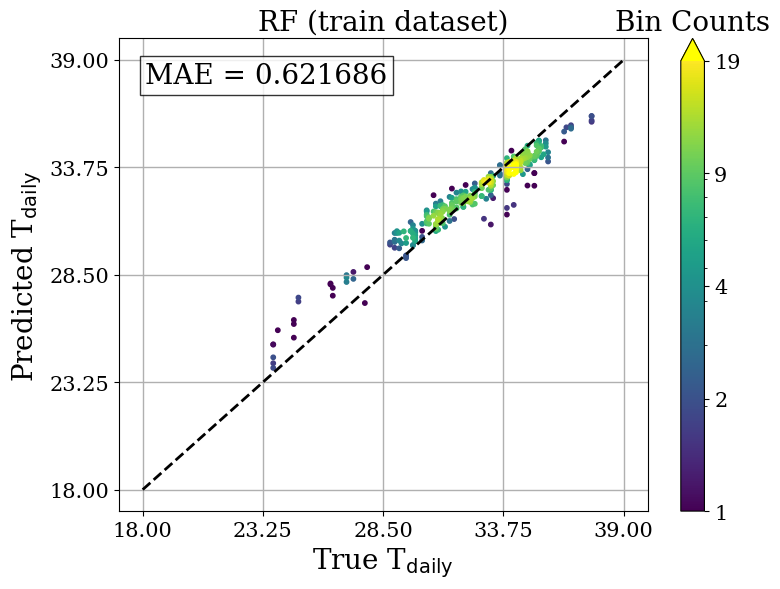

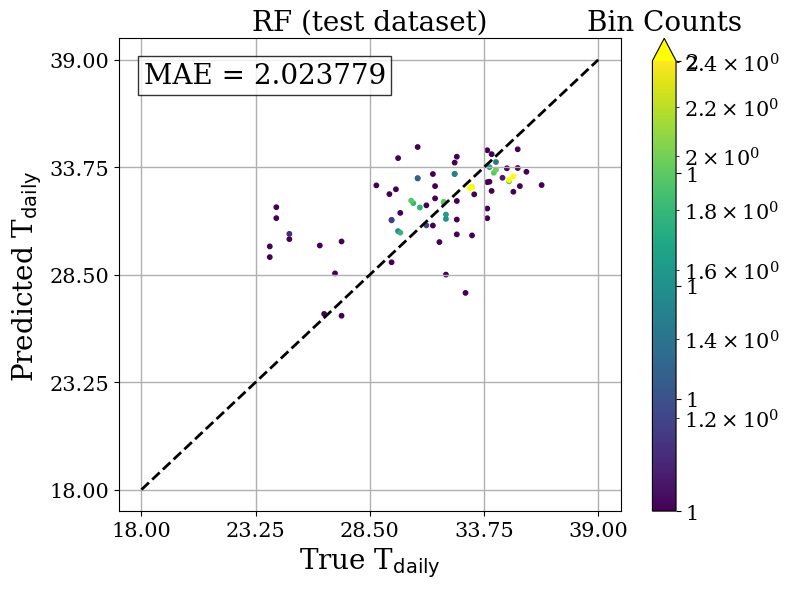

In [21]:
model_name = 'RF'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_test.png')

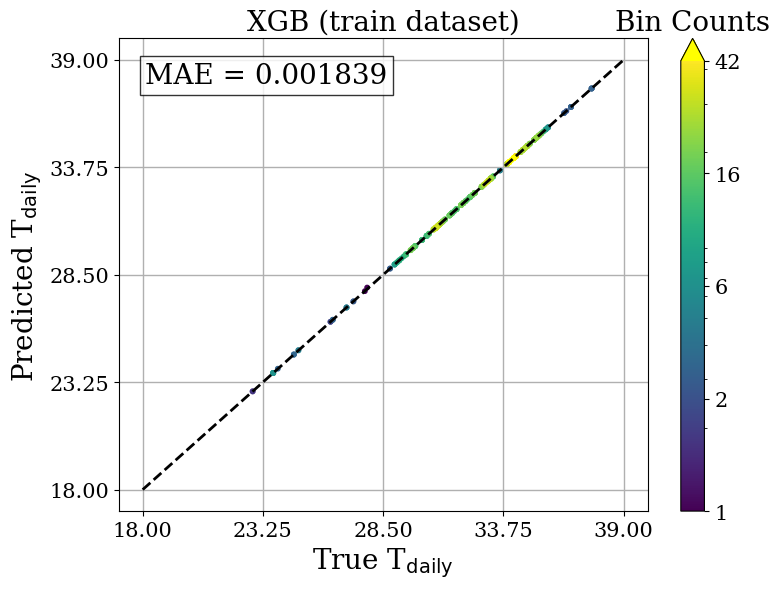

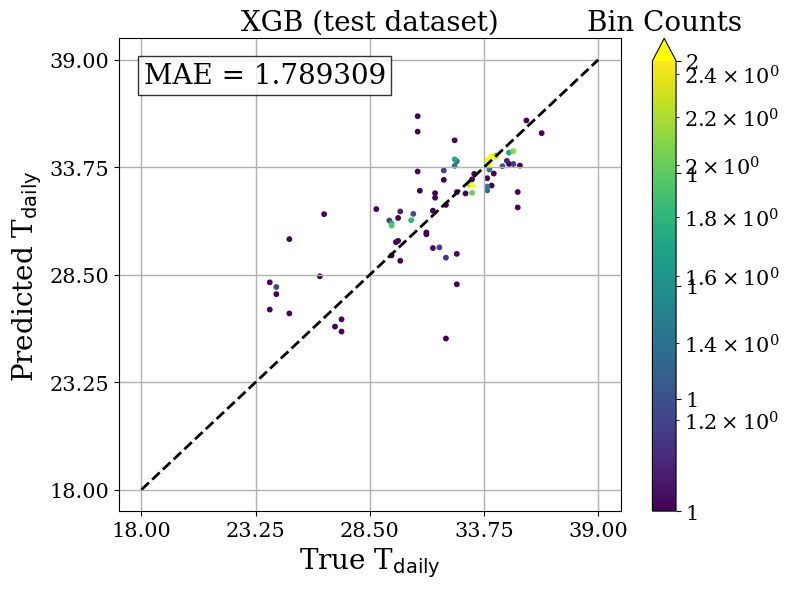

In [20]:
model_name = 'XGB'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_test.png')

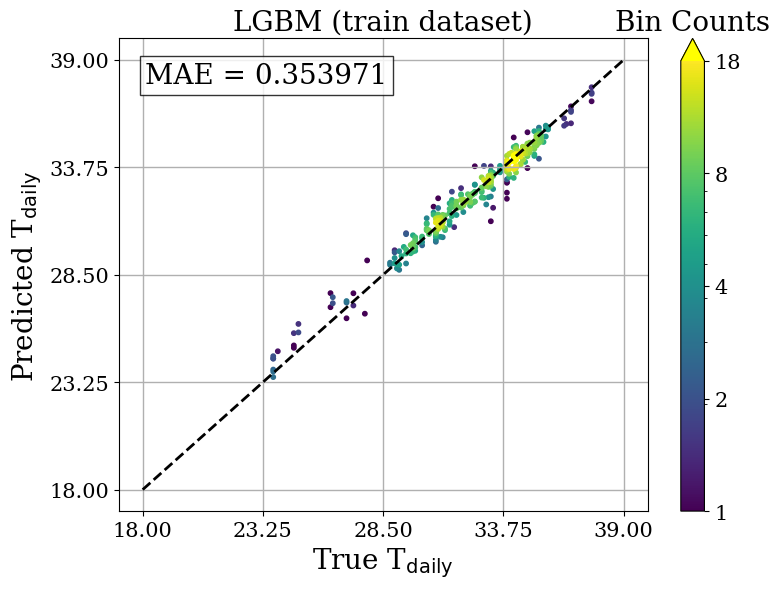

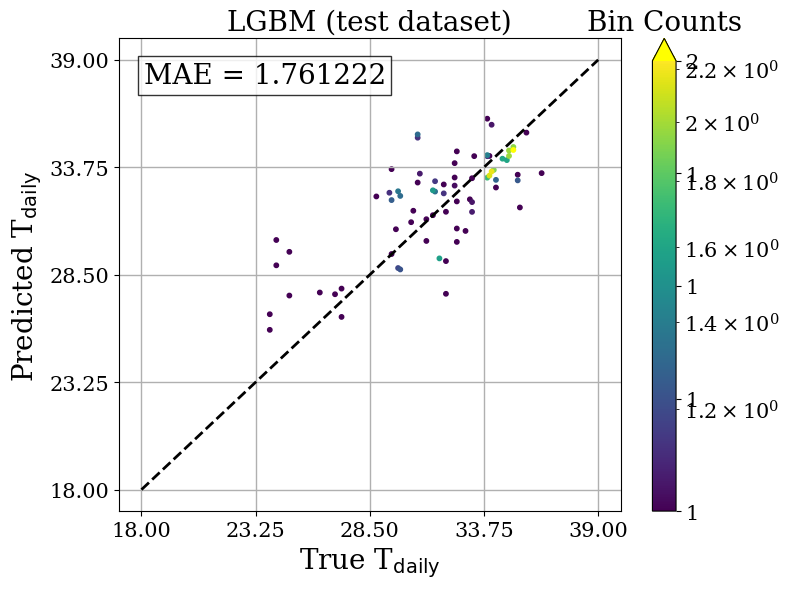

In [19]:
model_name = 'LGBM'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_test.png')

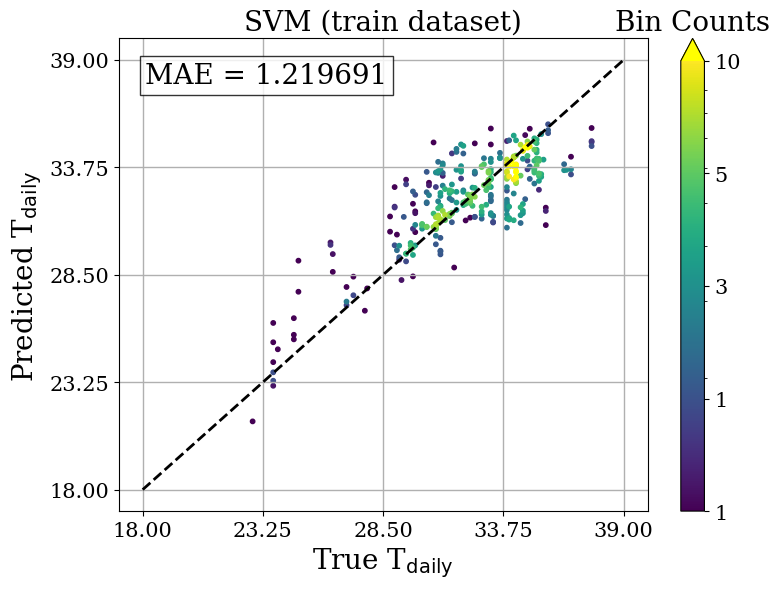

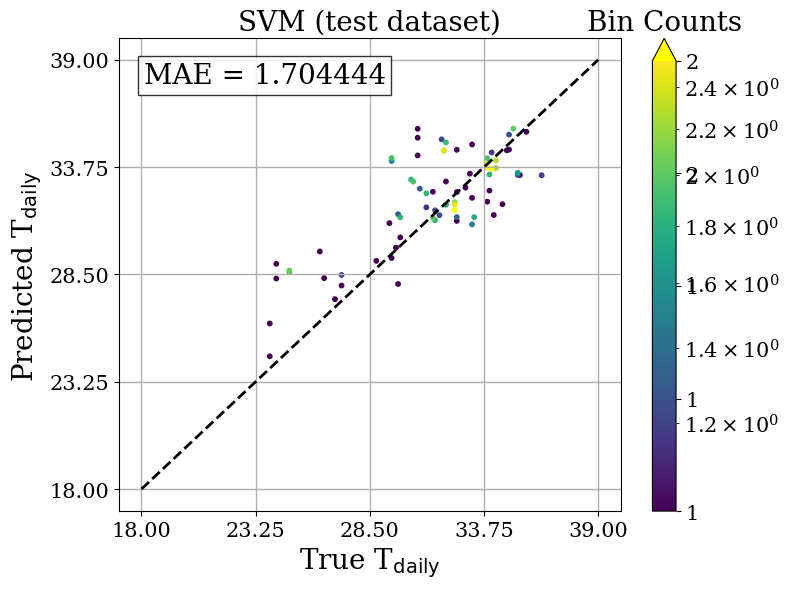

In [18]:
model_name = 'SVM'
df_pred_true_train = pd.read_csv(f'{save_path}/{model_name}_predtrue_train.csv')
df_pred_true_test  = pd.read_csv(f'{save_path}/{model_name}_predtrue_test.csv')

y_true_train = df_pred_true_train['y_true_train']
y_pred_train = df_pred_true_train['y_pred_train']

y_true_test = df_pred_true_test['y_true_test']
y_pred_test = df_pred_true_test['y_pred_test']

plot_kde_scatter_log_count(y_true_train, y_pred_train, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (train dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_train.png')
plot_kde_scatter_log_count(y_true_test, y_pred_test, global_min=global_min, global_max=global_max,
                          title=f'{model_name} (test dataset)', x_label=r'True T$_{\mathrm{daily}}$', y_label=r'Predicted T$_{\mathrm{daily}}$',
                          save_fig_path=f'Figures_summer/{model_name}_test.png')

In [35]:
for i, year in enumerate(range(2013, 2023 + 1)):
    with netCDF4.Dataset(f'{save_path}/max_temp_recons_{year}.nc') as nc_data:
        vars_list = list(nc_data.variables.keys())
        latitude = nc_data['latitude'][:].data
        longitude = nc_data['longitude'][:].data
        dates = nc_data['dates'][:].data

        RF = nc_data['RF'][:].data
        XGB = nc_data['XGB'][:].data
        LGBM = nc_data['LGBM'][:].data
        SVM = nc_data['SVM'][:].data
    
    print(dates)

    # Extract summer values
    season_indices = [i for i, date in enumerate(dates) if str(date)[4:6] in ['06', '07', '08']]
    print(year, dates[season_indices])
    
    RF_year_season = RF[:, :, season_indices]
    XGB_year_season = XGB[:, :, season_indices]
    LGBM_year_season = LGBM[:, :, season_indices]
    SVM_year_season = SVM[:, :, season_indices]

    print(year, np.shape(dates))

    if i != 0:
        RF_year_season = np.concatenate( [RF_year_season_old, RF_year_season], axis=2 )
        XGB_year_season = np.concatenate( [XGB_year_season_old, XGB_year_season], axis=2 )
        LGBM_year_season = np.concatenate( [LGBM_year_season_old, LGBM_year_season], axis=2 )
        SVM_year_season = np.concatenate( [SVM_year_season_old, SVM_year_season], axis=2 )
    
    RF_year_season_old = RF_year_season
    XGB_year_season_old = XGB_year_season
    LGBM_year_season_old = LGBM_year_season
    SVM_year_season_old = SVM_year_season

del RF; del XGB; del LGBM; del SVM
del RF_year_season_old
del XGB_year_season_old
del LGBM_year_season_old
del SVM_year_season_old

[20130512. 20130628. 20130730. 20130808. 20130816. 20130832. 20130908.
 20130916. 20130924.]
2013 [20130628. 20130730. 20130808. 20130816. 20130832.]
2013 (9,)
[20140508. 20140514. 20140524. 20140530. 20140608. 20140616. 20140624.
 20140700. 20140710. 20140726. 20140802. 20140812. 20140828. 20140912.
 20140920. 20140928.]
2014 [20140608. 20140616. 20140624. 20140700. 20140710. 20140726. 20140802.
 20140812. 20140828.]
2014 (16,)
[20150500. 20150510. 20150516. 20150526. 20150602. 20150618. 20150628.
 20150704. 20150728. 20150804. 20150814. 20150820. 20150830. 20150906.
 20150916. 20150922.]
2015 [20150602. 20150618. 20150628. 20150704. 20150728. 20150804. 20150814.
 20150820. 20150830.]
2015 (16,)
[20160504. 20160512. 20160520. 20160528. 20160612. 20160620. 20160628.
 20160706. 20160716. 20160722. 20160732. 20160808. 20160816. 20160824.
 20160900. 20160908. 20160924.]
2016 [20160612. 20160620. 20160628. 20160706. 20160716. 20160722. 20160732.
 20160808. 20160816. 20160824.]
2016 (17,)
[

In [26]:
df_GJ = gpd.read_file('GJ_boundary/gwangju_boundary.shp', encoding='UTF-8')
df_GJ

,BASE_DATE,SIGUNGU_NM,SIGUNGU_CD,geometry
0,20230701,����,24010,"POLYGON ((126.93071 35.16027, 126.93073 35.160..."
1,20230701,����,24020,"POLYGON ((126.84043 35.17848, 126.84054 35.178..."
2,20230701,����,24030,"POLYGON ((126.90108 35.15234, 126.90122 35.152..."
3,20230701,�ϱ�,24040,"POLYGON ((126.91111 35.25846, 126.91122 35.258..."
4,20230701,���걸,24050,"POLYGON ((126.76029 35.2587, 126.76105 35.2585..."


<Axes: >

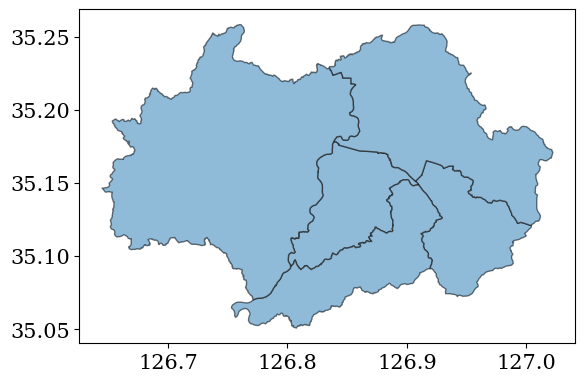

In [28]:
ax = df_GJ.plot(categorical =True) 
#ax.set_axis_off()

ax = plt.gca()  # Get current axis
df_GJ.plot(ax=ax, color='white', edgecolor='black', alpha=0.5)  # Overlay df_GJ with specified color and transparency

In [30]:
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.mpl.gridliner as gridliner

def plot_map(longitude, latitude, values, cmin, cmax, plot_title='title', label_title='values', cmap='jet', projection='Mollweide', bounds=None, dem_path=None, cbar_ticks=None, cbar_extend=None, points=None, save_fig_path=None):
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': getattr(ccrs, projection)()}, dpi=150)
    #fig.suptitle(plot_title, fontsize=16, y=0.67)
    #fig.suptitle(plot_title, fontsize=16, y=0.69)
    #fig.suptitle(plot_title, fontsize=16)
    #plt.tight_layout(rect=[0,0,1,0.95])
    #plt.subplots_adjust(top=0.64)
    #plt.tight_layout(rect=[0, 0, 1, 0.99])

    # Calculate the extent from the longitude and latitude

    # Set map extent if bounds are provided, else use the calculated extent
    if bounds == 'global':
        ax.set_global()
    elif bounds == 'korea':
        bounds = [125.7, 129.7, 33.9, 38.8]
        ax.set_extent(bounds, crs=ccrs.PlateCarree())
    elif bounds:
        ax.set_extent(bounds, crs=ccrs.PlateCarree())
    else:
        extent = [longitude.min(), longitude.max(), latitude.min(), latitude.max()]
        ax.set_extent(extent, crs=ccrs.PlateCarree())

    # Plot DEM as background if provided
    if dem_path:
        with rasterio.open(dem_path) as dem:
            dem_data = dem.read(1)  # Read the first band
            dem_extent = [dem.bounds.left, dem.bounds.right, dem.bounds.bottom, dem.bounds.top]
            ax.imshow(dem_data, origin='upper', extent=dem_extent, transform=ccrs.PlateCarree(), cmap='terrain', alpha=0.5)

    # Plot the data using pcolormesh
    im = ax.pcolormesh(longitude, latitude, values, transform=ccrs.PlateCarree(), cmap=cmap, vmin=cmin, vmax=cmax)
    ax.add_feature(cfeature.OCEAN, facecolor='lightblue')
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle='-', edgecolor='black')

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=1, color='black', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = gridliner.LONGITUDE_FORMATTER
    gl.yformatter = gridliner.LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'black'}
    gl.ylabel_style = {'size': 15, 'color': 'black'}

    # Add colorbar and enforce color limits
    if cbar_extend == None:
        cbar = fig.colorbar(im, ax=ax, orientation='horizontal', pad=0.05, shrink=0.5)
    else: # min, max, both
        cbar = fig.colorbar(im, ax=ax, orientation='horizontal', pad=0.05, shrink=0.5, extend=cbar_extend)
    cbar.set_label(label_title)
    if cbar_ticks is None:
        cbar.set_ticks([cmin, (cmin+cmax)/4, (cmin+cmax)*2/4, (cmin+cmax)*3/4, cmax])  # Set the ticks at min, 1/4, 2/4, 3/4, and max
        cbar.set_ticklabels([f'{cmin:.3f}', f'{(cmin+cmax)/4:.3f}', f'{(cmin+cmax)*2/4:.3f}', f'{(cmin+cmax)*3/4:.3f}', f'{cmax:.3f}'])
    else:
        cbar.set_ticks(cbar_ticks)
    # Ensure the color limits are set correctly on the image
    im.set_clim(cmin, cmax)

    # Gwangju region
    gpd.GeoSeries(df_GJ['geometry']).plot(ax=ax, color='none', edgecolor='black', linewidth=2)

    # Mark the specified point if provided
    if points:
        for point in points:
            pixel_y, pixel_x = point
            lon = longitude[pixel_y, pixel_x]
            lat = latitude[pixel_y, pixel_x]
            ax.plot(lon, lat, marker='*', color='red', markersize=10, transform=ccrs.PlateCarree())

    if save_fig_path is not None:
        plt.tight_layout()
        plt.savefig(save_fig_path, dpi=300, bbox_inches='tight', transparent=True)        

    plt.show()

    return fig, ax

/tmp/ipykernel_923626/1800640634.py:1: RuntimeWarning: Mean of empty slice
  RF_mean = np.nanmean(RF_year_season, axis=2)


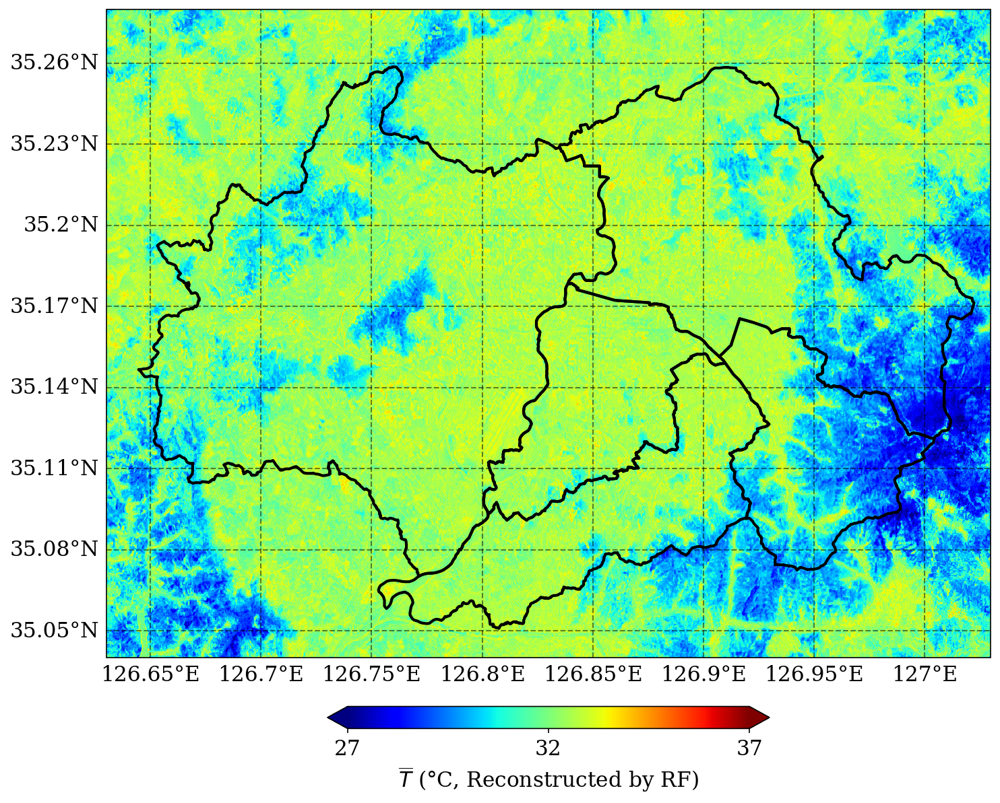

/tmp/ipykernel_923626/1800640634.py:7: RuntimeWarning: Mean of empty slice
  XGB_mean = np.nanmean(XGB_year_season, axis=2)


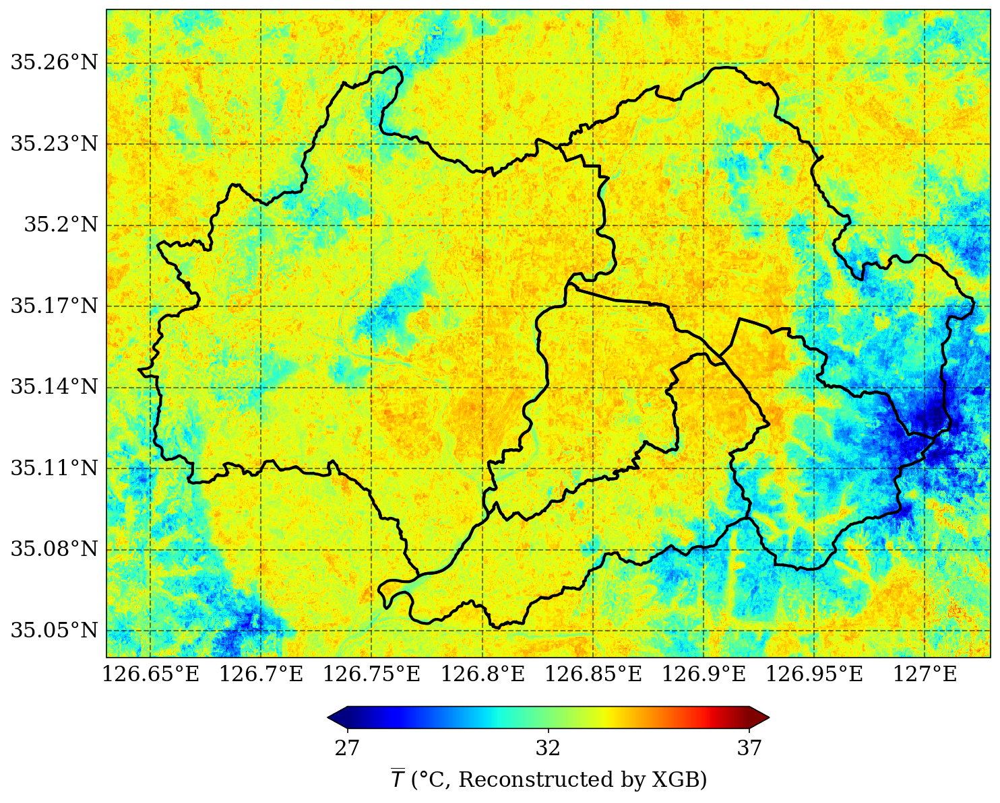

/tmp/ipykernel_923626/1800640634.py:13: RuntimeWarning: Mean of empty slice
  LGBM_mean = np.nanmean(LGBM_year_season, axis=2)


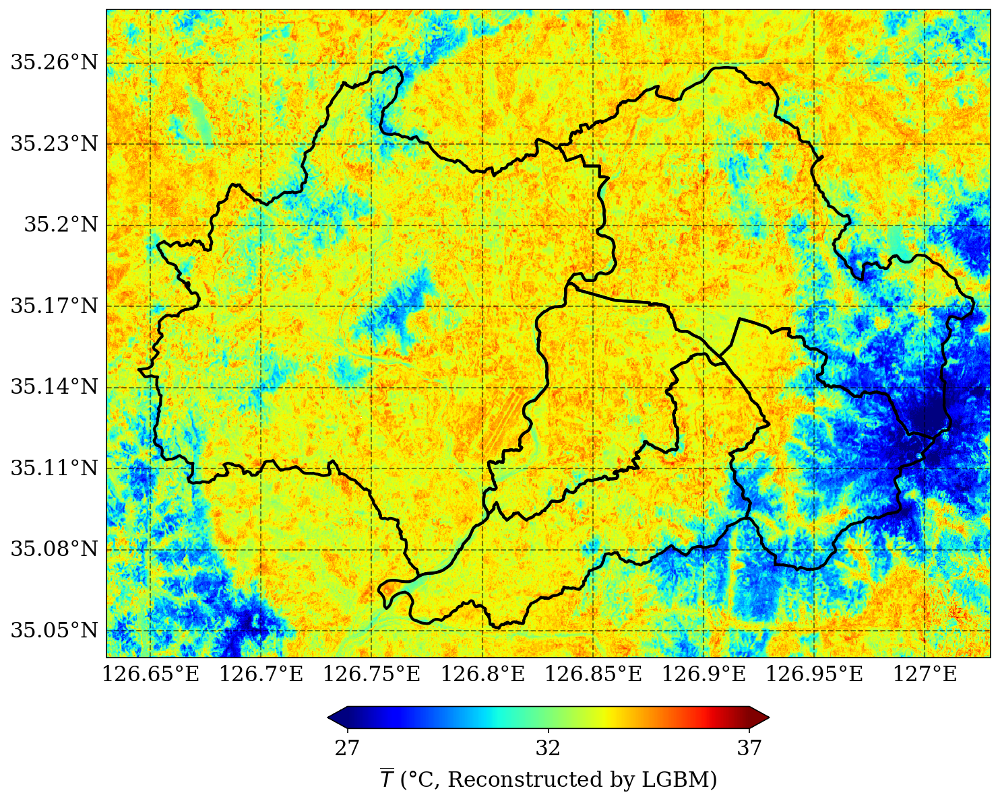

/tmp/ipykernel_923626/1800640634.py:19: RuntimeWarning: Mean of empty slice
  SVM_mean = np.nanmean(SVM_year_season, axis=2)


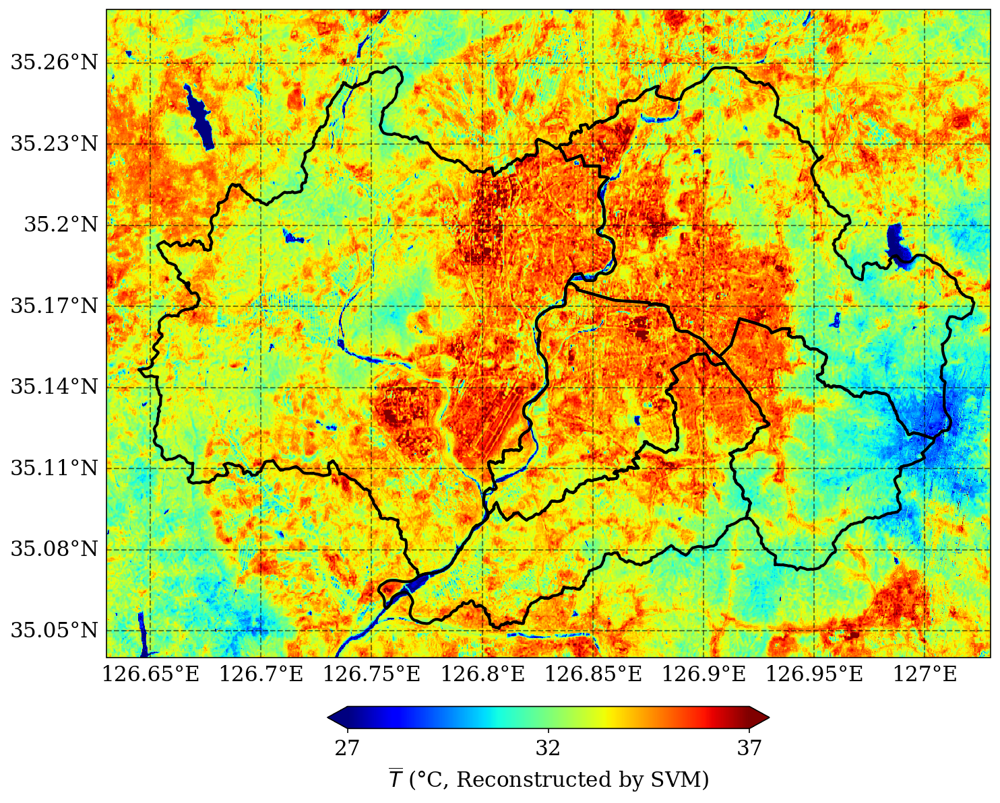

(<Figure size 1500x1500 with 2 Axes>, <GeoAxes: >)

In [36]:
RF_mean = np.nanmean(RF_year_season, axis=2)
plot_map(longitude, latitude, RF_mean, 27, 37, label_title=r'$\overline{T}$ ($\degree$C, Reconstructed by RF)',
               cbar_ticks=[27, 32, 37], cbar_extend='both',
               save_fig_path=f'Figures_summer/RF_mean.png',
               projection='PlateCarree')

XGB_mean = np.nanmean(XGB_year_season, axis=2)
plot_map(longitude, latitude, XGB_mean, 27, 37, label_title=r'$\overline{T}$ ($\degree$C, Reconstructed by XGB)',
               cbar_ticks=[27, 32, 37], cbar_extend='both',
               save_fig_path=f'Figures_summer/XGB_mean.png',
               projection='PlateCarree')

LGBM_mean = np.nanmean(LGBM_year_season, axis=2)
plot_map(longitude, latitude, LGBM_mean, 27, 37, label_title=r'$\overline{T}$ ($\degree$C, Reconstructed by LGBM)',
               cbar_ticks=[27, 32, 37], cbar_extend='both',
               save_fig_path=f'Figures_summer/LGBM_mean.png',
               projection='PlateCarree')

SVM_mean = np.nanmean(SVM_year_season, axis=2)
plot_map(longitude, latitude, SVM_mean, 27, 37, label_title=r'$\overline{T}$ ($\degree$C, Reconstructed by SVM)',
               cbar_ticks=[27, 32, 37], cbar_extend='both',
               save_fig_path=f'Figures_summer/SVM_mean.png',
               projection='PlateCarree')

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


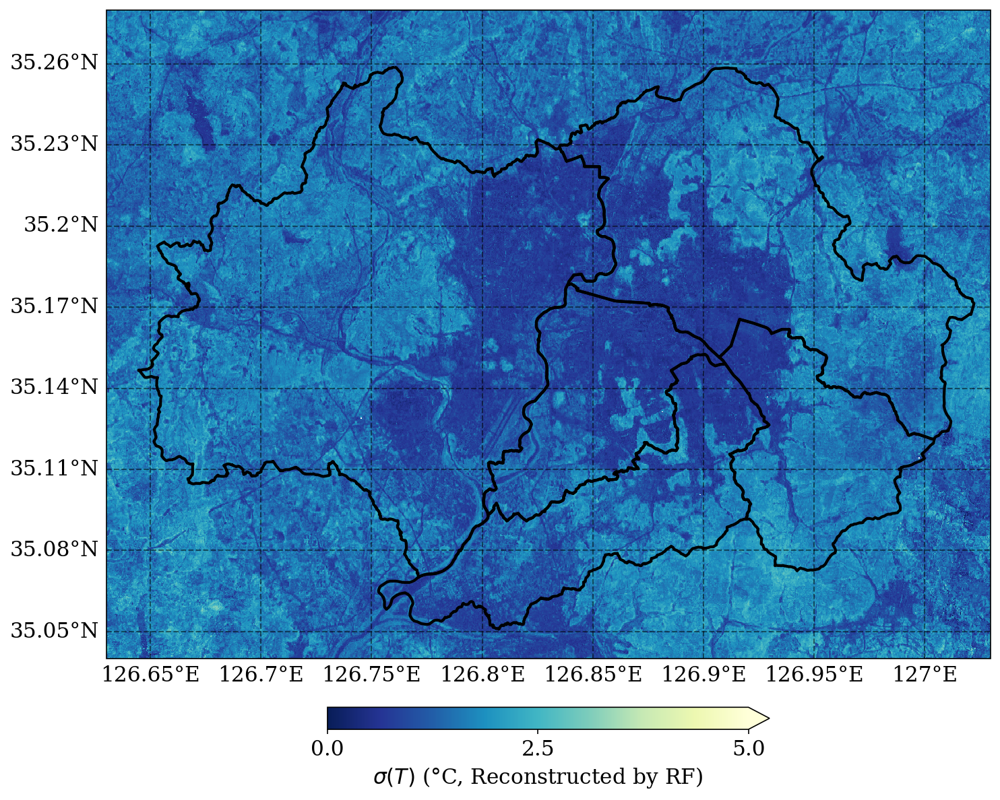

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


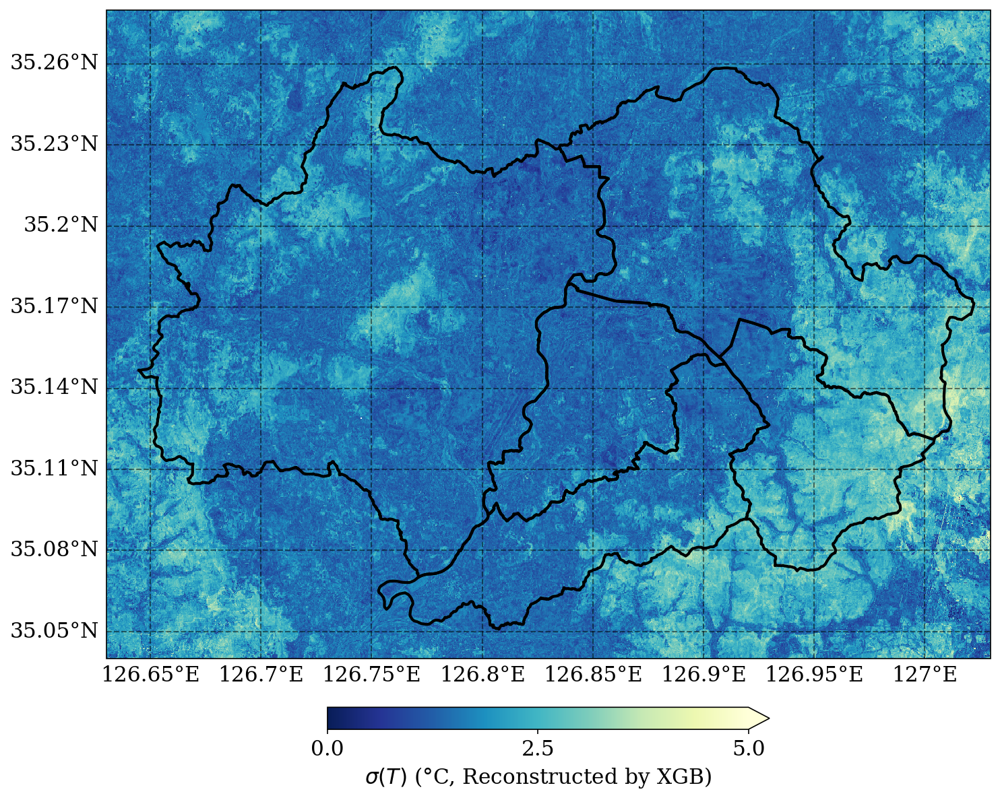

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


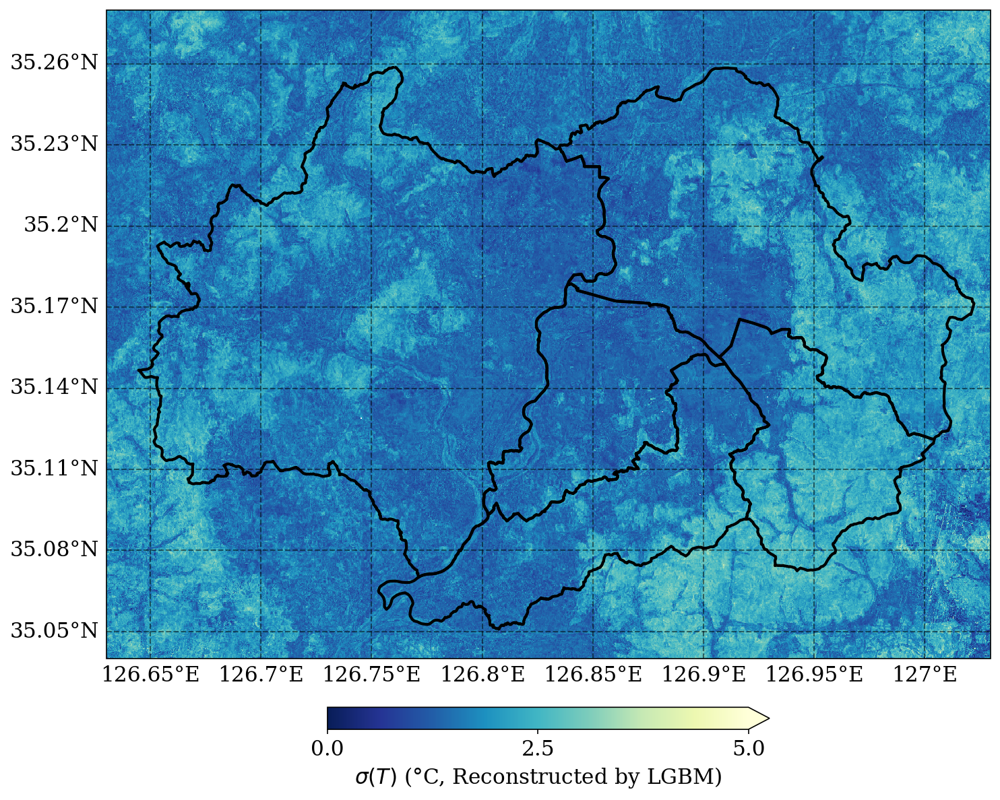

/home/subin/miniconda3/envs/cuml_env/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


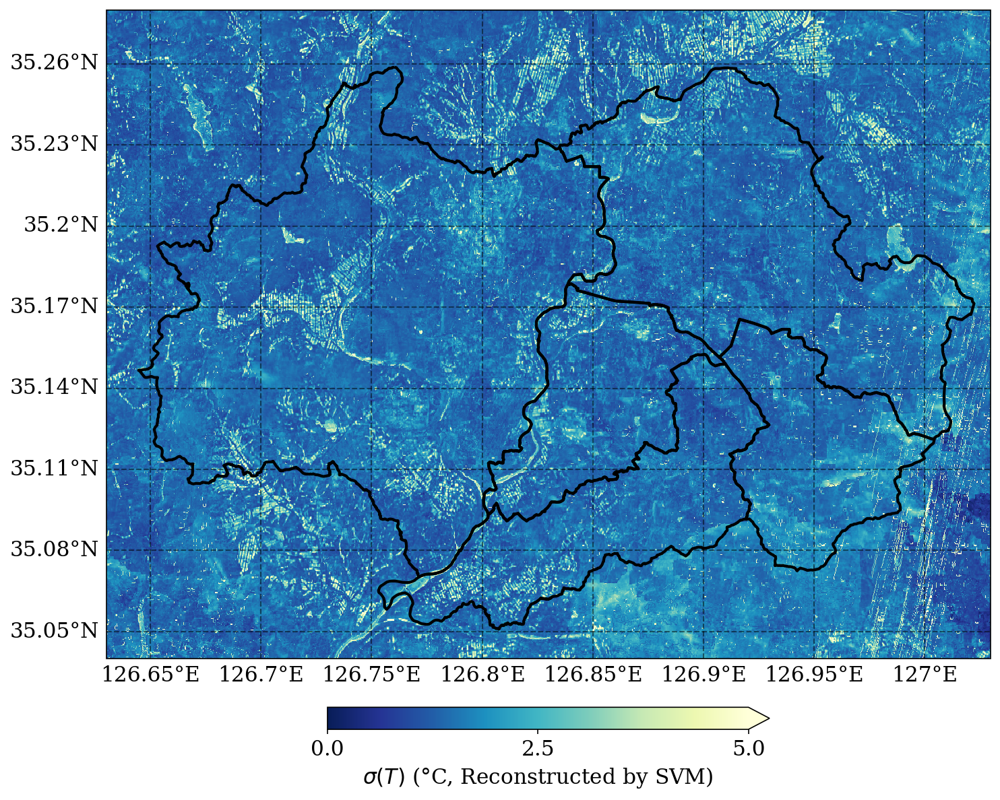

(<Figure size 1500x1500 with 2 Axes>, <GeoAxes: >)

In [37]:
RF_std = np.nanstd(RF_year_season, axis=2)
plot_map(longitude, latitude, RF_std, 0, 5, label_title=r'$\sigma(T)$ ($\degree$C, Reconstructed by RF)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu_r',
               save_fig_path=f'Figures_summer/RF_std.png',
               projection='PlateCarree')

XGB_std = np.nanstd(XGB_year_season, axis=2)
plot_map(longitude, latitude, XGB_std, 0, 5, label_title=r'$\sigma(T)$ ($\degree$C, Reconstructed by XGB)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu_r',
               save_fig_path=f'Figures_summer/XGB_std.png',
               projection='PlateCarree')

LGBM_std = np.nanstd(LGBM_year_season, axis=2)
plot_map(longitude, latitude, LGBM_std, 0, 5, label_title=r'$\sigma(T)$ ($\degree$C, Reconstructed by LGBM)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu_r',
               save_fig_path=f'Figures_summer/LGBM_std.png',
               projection='PlateCarree')

SVM_std = np.nanstd(SVM_year_season, axis=2)
plot_map(longitude, latitude, SVM_std, 0, 5, label_title=r'$\sigma(T)$ ($\degree$C, Reconstructed by SVM)',
               cbar_ticks=[0, 2.5, 5], cbar_extend='max', cmap='YlGnBu_r',
               save_fig_path=f'Figures_summer/SVM_std.png',
               projection='PlateCarree')

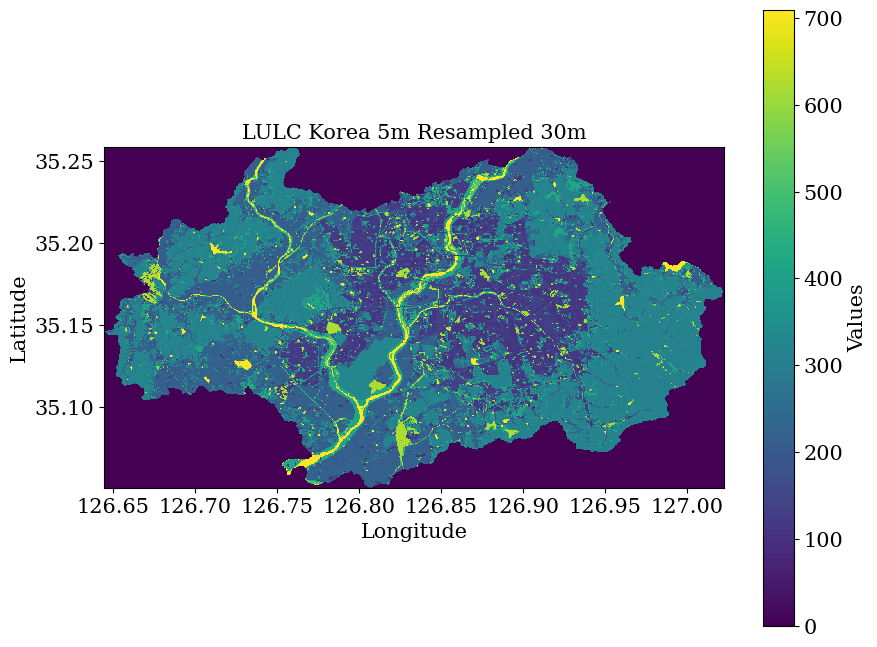

In [98]:
# Open the GeoTIFF file
#file_path = f'{cpuserver_data_FP}/LULC/ROK/South_Korea/LULC_Korea_5m_resampled_30m.tif'
file_path = f'{cpuserver_data_FP}/LULC/ROK/Gwangju/Gwangju_30m.tif'

with rasterio.open(file_path) as src:
    # Read the data from the first band (assuming single band data)
    LULC_data = src.read(1)
    
    # Get the coordinates for the pixels
    transform = src.transform
    width = src.width
    height = src.height

    # Get the bounds (left, bottom, right, top)
    bounds = src.bounds
    
    # Generate latitude and longitude for each pixel
    lon = np.linspace(bounds.left, bounds.right, width)
    lat = np.linspace(bounds.top, bounds.bottom, height)
    
    # Create meshgrid for plotting
    lon_grid, lat_grid = np.meshgrid(lon, lat)

    # Plotting
    plt.figure(figsize=(10, 8))
    plt.pcolormesh(lon_grid, lat_grid, LULC_data, cmap='viridis')
    plt.colorbar(label="Values")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("LULC Korea 5m Resampled 30m")
    plt.gca().set_aspect('equal', adjustable='box')
    plt.show()

In [99]:
latitude_ud = np.flipud(latitude)
#Resampled_LULC  = hData.Resampling(longitude, latitude_ud, lon_grid, lat_grid, LULC_data, agg_method='mode', mag_factor=2)
#np.save('Resampled_LULC.npy', Resampled_LULC)

In [100]:
Resampled_LULC = np.load('Resampled_LULC.npy')
np.shape(Resampled_LULC)

(800, 1333)

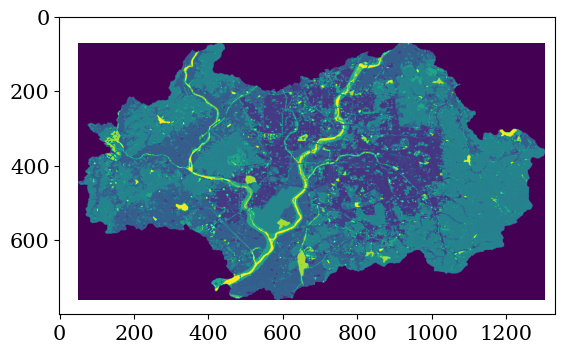

In [101]:
plt.imshow(Resampled_LULC)

In [19]:
#Resampled_LULC = Resampled_LULC.astype('int64')
np.unique(Resampled_LULC)

array([  0., 110., 120., 130., 140., 150., 160., 210., 220., 230., 240.,
       250., 310., 320., 330., 410., 420., 510., 610., 620., 710.,  nan])

/tmp/ipykernel_918178/3621823158.py:80: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='LULC', y='XGB', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_918178/3621823158.py:80: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(x='LULC', y='XGB', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_918178/3621823158.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='LULC', y='LGBM', data=data, ax=ax2, palette=palette, legend=False, cut=0, scale='width')
/tmp/ipykernel_918178/3621823158.py:86: FutureWarnin

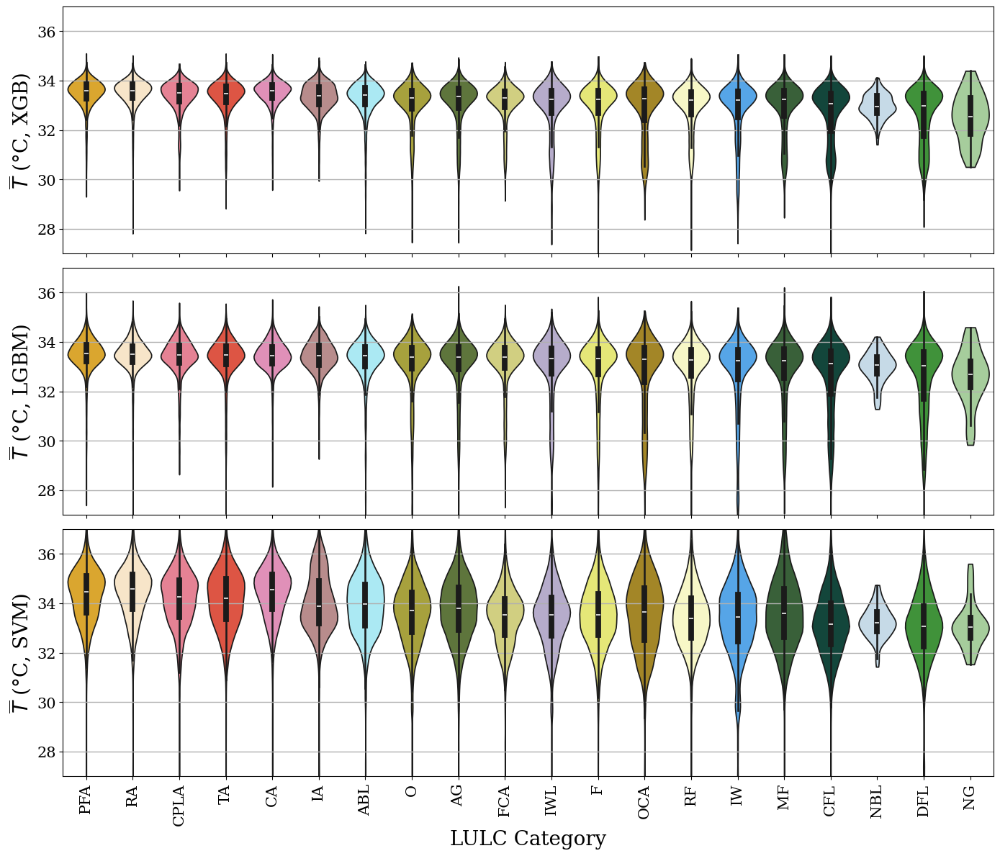

In [102]:
import matplotlib.colors as mcolors
import matplotlib.font_manager as fm

plt.rc('font', family='serif')

LGBM_flat = LGBM_mean.flatten()
XGB_flat = XGB_mean.flatten()
SVM_flat = SVM_mean.flatten()

LULC_flat = Resampled_LULC.flatten()
LULC_flat[LULC_flat == 0] = np.nan

# Helper function to convert RGB fractions to hex
def rgb_to_hex(r, g, b):
    return mcolors.to_hex([r/255, g/255, b/255])

# Define the lulc_dict with RGB fractions and convert them to hex
lulc_dict = {
    110: ('RA', rgb_to_hex(254, 230, 194)),    # Residential Area
    120: ('IA', rgb_to_hex(192, 132, 132)),    # Industrial Area
    130: ('CA', rgb_to_hex(237, 131, 184)),    # Commercial Area
    140: ('CPLA', rgb_to_hex(246, 113, 138)),  # Cultural Physical Leisure Area
    150: ('TA', rgb_to_hex(247, 65, 42)),      # Transportational Area
    160: ('PFA', rgb_to_hex(246, 177, 18)),    # Public Facility Area
    
    210: ('RF', rgb_to_hex(255, 255, 191)),    # Rice Field
    220: ('F', rgb_to_hex(247, 249, 102)),     # Field
    230: ('FCA', rgb_to_hex(223, 220, 115)),   # Facility Cultivation Area
    240: ('O', rgb_to_hex(184, 177, 44)),      # Orchard
    250: ('OCA', rgb_to_hex(184, 145, 18)),    # Other Cultivation Area
    
    310: ('DFL', rgb_to_hex(51, 160, 44)),     # Deciduous forest land
    320: ('CFL', rgb_to_hex(10, 79, 64)),      # Coniferous forest land
    330: ('MF', rgb_to_hex(51, 102, 51)),      # Mixed forest
    
    410: ('NG', rgb_to_hex(161, 213, 148)),    # Natural grassland
    420: ('AG', rgb_to_hex(96, 126, 51)),      # Artificial grassland
    
    510: ('IWL', rgb_to_hex(180, 167, 208)),   # Inland wet land
    
    610: ('NBL', rgb_to_hex(193, 219, 236)),   # Natural bare land
    620: ('ABL', rgb_to_hex(159, 242, 255)),   # Artificial bare land
    
    710: ('IW', rgb_to_hex(62, 167, 255)),     # Inland water
    9999: ('nan', rgb_to_hex(255, 255, 255))
}

# Replace NaN values from LGBM_flat and XGB_flat
valid_indices = ~np.isnan(LGBM_flat) & ~np.isnan(XGB_flat) & ~np.isnan(LULC_flat) & ~np.isnan(SVM_flat)
LGBM_flat = LGBM_flat[valid_indices]
XGB_flat = XGB_flat[valid_indices]
SVM_flat = SVM_flat[valid_indices]
LULC_flat = LULC_flat[valid_indices]

# Create a DataFrame to organize the new data
data = pd.DataFrame({
    'LULC': LULC_flat.astype(int),
    'LGBM': LGBM_flat,
    'XGB': XGB_flat,
    'SVM': SVM_flat
})

# Replace LULC numeric values with their corresponding names
data['LULC'] = data['LULC'].map({k: v[0] for k, v in lulc_dict.items() if k != 0})

# Calculate median values for LGBM and XGB for each LULC category and sort the categories
median_LGBM = data.groupby('LULC')['LGBM'].median().sort_values(ascending=False)
sorted_LULC = median_LGBM.index

# Map LULC to the sorted categories
data['LULC'] = pd.Categorical(data['LULC'], categories=sorted_LULC, ordered=True)

# Create a custom color palette using the LULC color dictionary
palette = {v[0]: v[1] for k, v in lulc_dict.items() if k != 0}

# Create the figure and the subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(14, 12), sharex=True)

# Plot LGBM violin plot with a reversed Blues color palette
sns.violinplot(x='LULC', y='XGB', data=data, ax=ax1, palette=palette, legend=False, cut=0, scale='width')
ax1.set_xlabel('')
ax1.set_ylabel('$\overline{T}$ ($\degree$C, XGB)', fontsize=20)
ax1.set_ylim(27, 37)  # Set y-axis limits for ax1

# Plot XGB violin plot with a custom color palette
sns.violinplot(x='LULC', y='LGBM', data=data, ax=ax2, palette=palette, legend=False, cut=0, scale='width')
ax2.set_xlabel('LULC Category', fontsize=20)
ax2.set_ylabel('$\overline{T}$ ($\degree$C, LGBM)', fontsize=20)
ax2.set_ylim(27, 37)  # Set y-axis limits for ax2

# Plot SVM violin plot with a custom color palette
sns.violinplot(x='LULC', y='SVM', data=data, ax=ax3, palette=palette, legend=False, cut=0, scale='width')
ax3.set_xlabel('LULC Category', fontsize=20)
ax3.set_ylabel('$\overline{T}$ ($\degree$C, SVM)', fontsize=20)
ax3.set_ylim(27, 37)  # Set y-axis limits for ax3

# Rotate x labels for better readability
plt.xticks(rotation=90)

# Remove titles
ax1.set_title('')
ax2.set_title('')
ax3.set_title('')

ax1.grid(True, axis='y')
ax2.grid(True, axis='y')
ax3.grid(True, axis='y')

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0)  # Remove space between plots

plt.tight_layout()
# Save the figure (optional)
plt.savefig(f'Figures_summer/LGBM_XGB_SVM_LULC_violin.png', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

In [178]:
from scipy import ndimage
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from matplotlib import cm
from matplotlib.colors import Normalize
from scipy.interpolate import interpn
import matplotlib.ticker as ticker

import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.mpl.gridliner as gridliner

import rasterio
from rasterio.plot import show
from tqdm import tqdm
from PIL import Image
import rioxarray

def plot_LULC_map(longitude, latitude, values, projection='PlateCarree', bounds=None, points=None, save_fig_path=None):
    # Create a colormap from the defined colors
    max_value = max(lulc_dict.keys())
    cmap_colors = [lulc_dict[i][1] for i in sorted(lulc_dict)]
    labels = [lulc_dict[i][0] for i in sorted(lulc_dict)]
    cmap = ListedColormap(cmap_colors)

    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': getattr(ccrs, projection)()}, dpi=150)

    # Set geographic bounds if specified
    if bounds:
        ax.set_extent(bounds, crs=ccrs.PlateCarree())

    # Add map features
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.OCEAN, facecolor='azure')
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')

    print(np.unique(values))
    # Plot the data
    mesh = ax.pcolormesh(longitude, latitude, values, cmap=cmap, transform=ccrs.PlateCarree())

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=1, color='black', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    gl.xformatter = gridliner.LONGITUDE_FORMATTER
    gl.yformatter = gridliner.LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'black'}
    gl.ylabel_style = {'size': 15, 'color': 'black'}

    # Create legend patches for detailed legend
    legend_patches = [mpatches.Patch(color=cmap_colors[i], label=labels[i]) for i in range(len(labels))]
    # Display the legend in 4 columns as requested
    legend = ax.legend(handles=legend_patches, title='Land Cover Classes', loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=False, ncol=3)
    
    if points:
        for point in points:
            pixel_y, pixel_x = point
            ax.plot(pixel_x, pixel_y, marker='*', color='black', markersize=10, transform=ccrs.PlateCarree())
    
    if save_fig_path != None:
        plt.tight_layout()
        plt.savefig(save_fig_path, dpi=300, bbox_inches='tight')

    plt.show()

[(35.1144, 126.9974), (35.1008, 126.8985), (35.1289, 126.7452), (35.1368, 126.9288), (35.2303, 126.8408), (35.1316, 126.8813)]
[110. 120. 130. 140. 150. 160. 210. 220. 230. 240. 250. 310. 320. 330.
 410. 420. 510. 610. 620. 710.  nan]


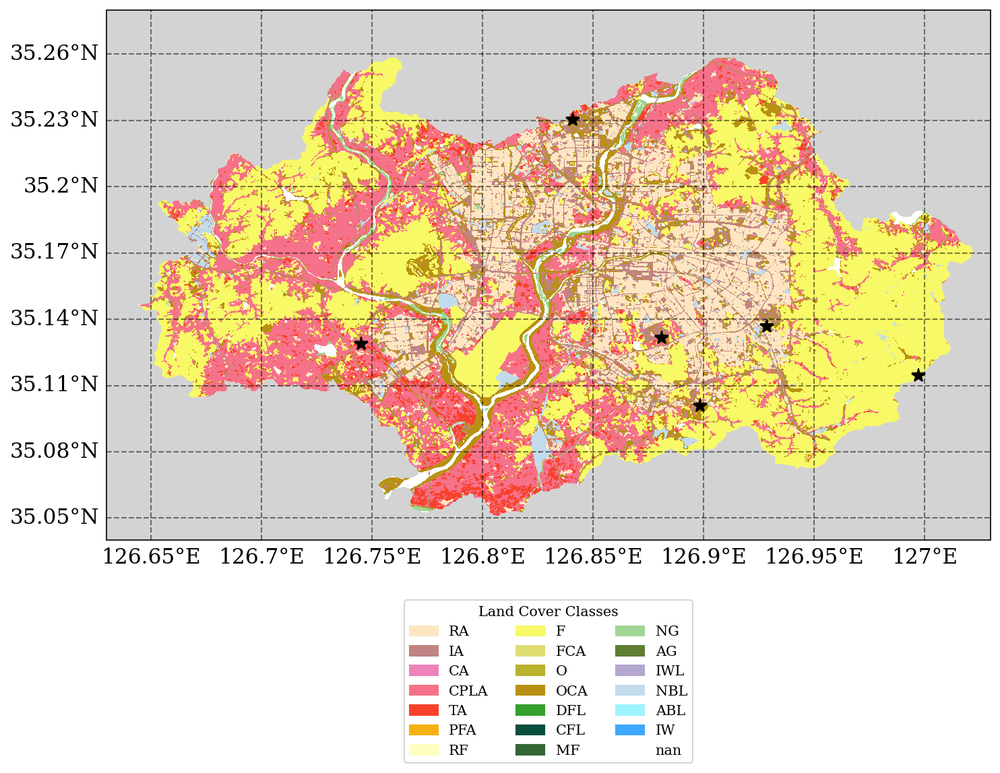

In [180]:
insitu_dict = {
    316:(35.1144, 126.9974), # MDS  
    689:(35.1008, 126.8985), # GJNG 
    708:(35.1289, 126.7452), # GS   
    722:(35.1368, 126.9288), # JSD  
    783:(35.2303, 126.8408), # GGW  
    788:(35.1316, 126.8813)  # PA   
}


select_point_list = [insitu_dict[316], insitu_dict[689], insitu_dict[708], insitu_dict[722], insitu_dict[783], insitu_dict[788]]
print(select_point_list)

Resampled_LULC[Resampled_LULC == np.nan] = 0

plot_LULC_map(longitude, latitude_ud, Resampled_LULC,
              points=select_point_list,
              save_fig_path=f'Figures/LULC_map.png')